In [1]:
class Config:
    DATA_DIR = '../data/'
    AUDIO_DIR = DATA_DIR + 'audio/'
    TEXT_DIR = DATA_DIR + 'text/'
    DATASET_DIR = 'dataset/'
    
    KAGGLE_DATA_TAG = 'linogova/marine-radio-chatter-bridge-2-bridge-communication/1'
    KAGGLE_DATA_DIR = 'Marine_audio/'

config = Config()

In [2]:
from pydub import AudioSegment
import os
import scipy.io.wavfile as wav
import numpy as np
from IPython.display import Audio, display

wav_file_path = "data/17329-20230629-0004.wav"
mp3_file_path = "data/17329-20230629-0004.mp3"
audio = AudioSegment.from_mp3(mp3_file_path)
audio = audio.set_frame_rate(16000)
audio.export(wav_file_path, format="wav")

# Load the audio file
sample_rate, audio_data = wav.read(wav_file_path)
print(f"Sample rate: {sample_rate} Hz")
print(audio_data.shape)
# If stereo, convert to mono
if len(audio_data.shape) == 2:
    audio_data = np.mean(audio_data, axis=1)
    
display(Audio(audio_data, rate=sample_rate))


Sample rate: 16000 Hz
(7863484,)


In [ ]:
import torch
from scipy import signal
import matplotlib.pyplot as plt

def lowpass_filter(audio_data, sr):
    # Create a lowpass filter
    b, a = signal.butter(4, 1300, 'low', fs=float(sr))
    # Apply the lowpass filter
    filtered_audio_data = signal.filtfilt(b, a, audio_data)
    return filtered_audio_data

def apply_rms_normalization(waveform):
    rms_value = waveform.pow(2).mean().sqrt()  # Calculate RMS value of the waveform
    target_rms = 0.1  # Example target RMS value
    normalized_waveform = waveform * (target_rms / rms_value)  # Scale waveform to desired RMS value
    return normalized_waveform

norm_audio_data = apply_rms_normalization(torch.tensor(audio_data, dtype=torch.float32))

# plot the original and normalized audio data
plt.figure(figsize=(12, 3))
plt.plot(np.arange(len(audio_data)) / sample_rate, audio_data, label='Original Audio Data', linewidth=0.5)
plt.plot(np.arange(len(norm_audio_data)) / sample_rate, norm_audio_data, label='Normalized Audio Data', linewidth=0.5)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.legend()
plt.show()


/home/tobias/Desktop/Uni/SS24/NLP/UKW_SpeachToText/.venv/lib/python3.12/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


In [4]:
# read the json file
import json

json_file_path = "data/17329-20230629-0004.json"
with open(json_file_path, 'r') as f:
    metadata = json.load(f)

text_data = metadata[0]

print(text_data.keys())


dict_keys(['start', 'end', 'text', 'words', 'speaker'])


/tmp/ipykernel_54383/539025387.py:31: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('NLP_AudioSignal.png')
/home/tobias/Desktop/Uni/SS24/NLP/UKW_SpeachToText/.venv/lib/python3.12/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


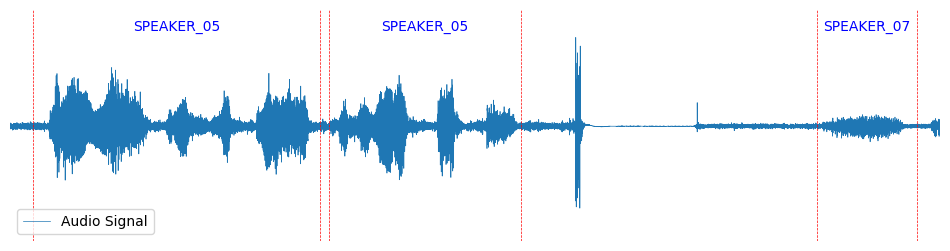

In [5]:
import matplotlib.pyplot as plt

md = metadata[:3]

# Convert the start and end times from seconds to sample indices
start_sample = int(text_data['start'] * sample_rate)
end_sample = int(text_data['end'] * sample_rate)

# Plot the audio signal
plt.figure(figsize=(12, 3))
# Plot the entire audio signal with width 0.5
plt.plot(np.arange(len(audio_data)) / sample_rate, audio_data, label='Audio Signal', linewidth=0.5)
plt.xlim([md[0]['start'] - 0.1, md[-1]['end'] + 0.1])

plt.xlabel('Time [s]')
plt.ylabel('Amplitude')

# Annotate the words on the plot
for speaker_info in md:
    speaker = speaker_info['speaker']
    speaker_start = speaker_info['start']
    speaker_end = speaker_info['end']
    plt.axvline(x=speaker_start, color='r', linestyle='--', linewidth=0.5)
    plt.axvline(x=speaker_end, color='r', linestyle='--', linewidth=0.5)
    plt.text((speaker_start + speaker_end) / 2, max(audio_data) * 0.9, speaker, horizontalalignment='center', fontsize=10, color='blue')

# Display the plot
plt.legend()
# remove the axis
plt.axis('off')
plt.savefig('NLP_AudioSignal.png')
plt.show()

/tmp/ipykernel_54383/1374778026.py:28: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('NLP_AudioSignal.png')


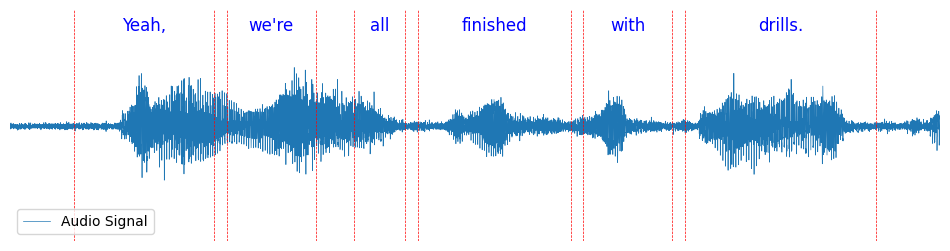

In [6]:
import matplotlib.pyplot as plt

# Convert the start and end times from seconds to sample indices
start_sample = int(text_data['start'] * sample_rate)
end_sample = int(text_data['end'] * sample_rate)

# Plot the audio signal
plt.figure(figsize=(12, 3))
# Plot the entire audio signal with width 0.5
plt.plot(np.arange(len(audio_data)) / sample_rate, audio_data, label='Audio Signal', linewidth=0.5)
plt.xlim([text_data['start'] - 0.1, text_data['end'] + 0.1])
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')

# Annotate the words on the plot
for word_info in text_data['words']:
    word = word_info['word']
    word_start = word_info['start']
    word_end = word_info['end']
    plt.axvline(x=word_start, color='r', linestyle='--', linewidth=0.5)
    plt.axvline(x=word_end, color='r', linestyle='--', linewidth=0.5)
    plt.text((word_start + word_end) / 2, max(audio_data) * 0.9, word, horizontalalignment='center', fontsize=12, color='blue')

# Display the plot
plt.legend()
# remove the axis
plt.axis('off')
plt.savefig('NLP_AudioSignal.png')
plt.show()

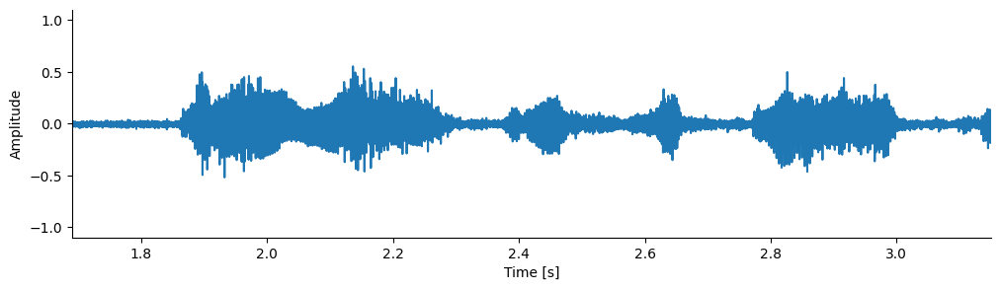

In [7]:
import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.rcParams['axes.spines.left'] = True
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['axes.spines.bottom'] = True

x_scale = np.arange(len(audio_data)) / sample_rate

audio_data_scaled = audio_data / np.max(np.abs(audio_data))

plt.figure(figsize=(12, 3))
plt.plot(x_scale, audio_data_scaled)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.xlim([text_data['start'] - 0.1, text_data['end'] + 0.1])

plt.savefig('NLP_AudioSignal_0.png')
plt.show()



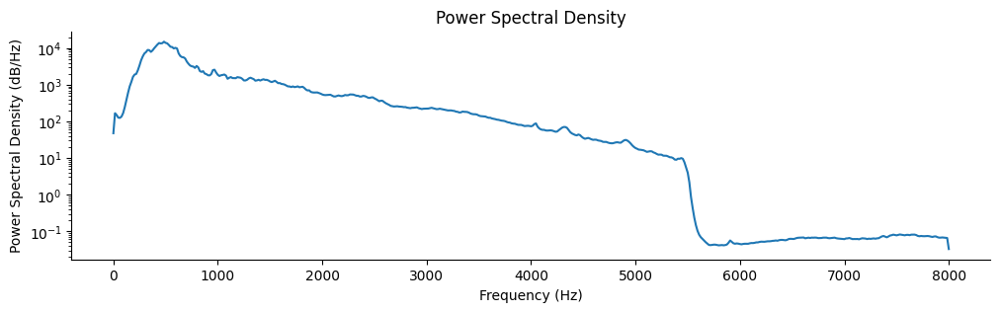

In [8]:
import numpy as np
from scipy import signal
import matplotlib as mpl

mpl.rcParams['axes.spines.left'] = True
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['axes.spines.bottom'] = True

# plot the power spectral density
f, Pxx = signal.welch(audio_data, sample_rate, nperseg=1024)
plt.figure(figsize=(12, 3))
plt.semilogy(f, Pxx)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power Spectral Density (dB/Hz)')
plt.title('Power Spectral Density')
plt.savefig('NLP_PSD.png')

plt.show()

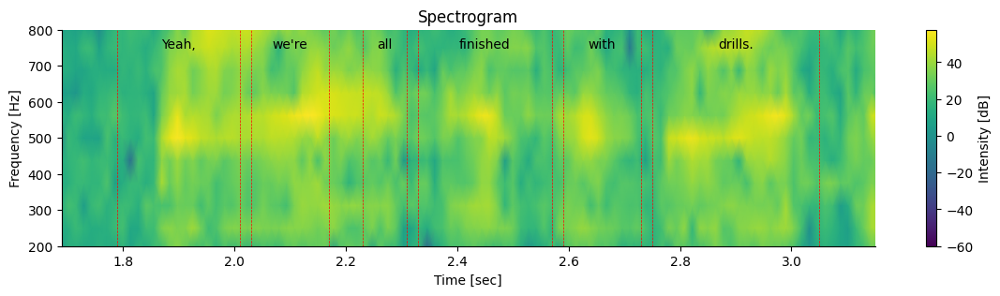

In [9]:
# Extract a 5-second sample from the audio data
sample_audio = audio_data[:sample_rate * 5]

# Compute the spectrogram of the audio sample
f, t, Sxx = signal.spectrogram(sample_audio, sample_rate)

# Plot the spectrogram
plt.figure(figsize=(14, 3))
plt.pcolormesh(t, f, 10 * np.log10(Sxx + 1e-6), shading='gouraud')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.title("Spectrogram")
plt.colorbar(label='Intensity [dB]')
plt.ylim(200, 800)  # Adjust as needed for your audio signal
plt.xlim([text_data['start'] - 0.1, text_data['end'] + 0.1])
# Annotate the words on the spectrogram
for word_info in text_data['words']:
    word = word_info['word']
    word_start = word_info['start']
    word_end = word_info['end']
    if word_start < 5:  # Only annotate words within the first 5 seconds
        plt.axvline(x=word_start, color='r', linestyle='--', linewidth=0.5)
        plt.axvline(x=word_end, color='r', linestyle='--', linewidth=0.5)
        plt.text((word_start + word_end) / 2, 750, word, horizontalalignment='center', fontsize=10, color='black')

plt.savefig('NLP_Spectogram.png')
plt.show()

In [34]:
import sounddevice as sd
print(audio_data.shape)
sd.play(audio_data[:4*16000], 16000)

(7863484,)


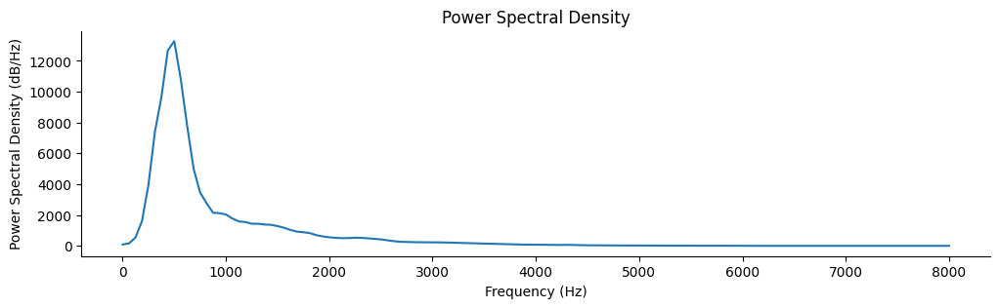

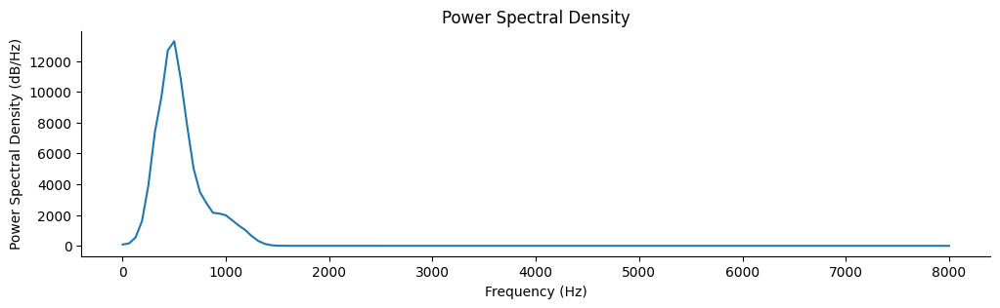

In [43]:
import numpy as np
from scipy import signal
import matplotlib as mpl
import sounddevice as sd


def lowpass_filter(audio_data):
    # Create a lowpass filter
    b, a = signal.butter(4, 1300, 'low', fs=sample_rate)
    # Apply the lowpass filter
    filtered_audio_data = signal.filtfilt(b, a, audio_data)
    return filtered_audio_data

filtered_audio_data = lowpass_filter(audio_data)

sd.play(filtered_audio_data[: 4* 16000], 16000)

mpl.rcParams['axes.spines.left'] = True
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['axes.spines.bottom'] = True

# plot the power spectral density
f, Pxx = signal.welch(audio_data, sample_rate, nperseg=None)
plt.figure(figsize=(12, 3))
plt.plot(f, Pxx)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power Spectral Density (dB/Hz)')
plt.title('Power Spectral Density')
plt.savefig('NLP_PSD.png')
plt.show()

# plot the power spectral density
f, Pxx = signal.welch(filtered_audio_data, sample_rate, nperseg=None)
plt.figure(figsize=(12, 3))
plt.plot(f, Pxx)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power Spectral Density (dB/Hz)')
plt.title('Power Spectral Density')
plt.savefig('NLP_PSD.png')
plt.show()

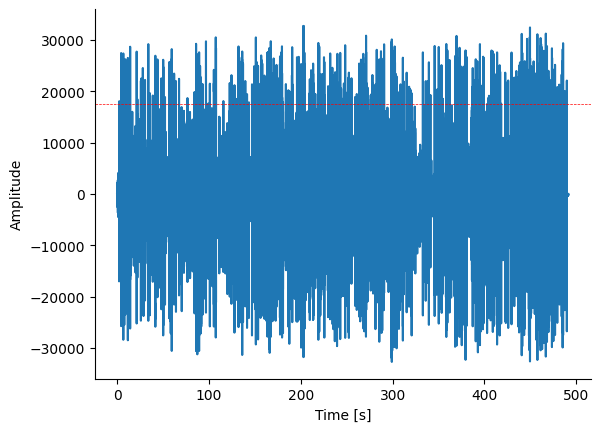

In [18]:
# compute the upper quantile of the audio data
quantile = np.quantile(audio_data, 0.999)

audio_x_scale = np.arange(len(audio_data)) / sample_rate
plt.plot(audio_x_scale, audio_data)
plt.axhline(y=quantile, color='r', linestyle='--', linewidth=0.5)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.show()

# threshold the audio data
thresholded_audio_data = np.where(audio_data < quantile, audio_data, quantile)